# Whale Project: Part 2
#### 1. Business Understanding
How do Gray and Blue Whales intersect with global shipping routes?

#### 2. Data Understanding

Here we will load the blue and gray whale data:

In [2]:
import folium
import pandas as pd
import geopandas as gpd
import numpy as np
import rasterio as rio
from shapely.geometry import Point
import calendar
from branca.element import Template, MacroElement


# Load gray whale data
df = pd.read_csv('data/obis_seamap_species_180521_points.csv', encoding = 'ISO-8859-1')

df['date_time'] = pd.to_datetime(df['date_time'])
df['month'] = df['date_time'].dt.month.apply(lambda x: calendar.month_name[x])
geometry = [Point(xy) for xy in zip(df['longitude'], df['latitude'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry)

# Load blue whale data
bdf = pd.read_csv('data/obis_seamap_species_180528_points.csv', encoding = 'ISO-8859-1')

bdf['date_time'] = pd.to_datetime(bdf['date_time'])
bdf['month'] = bdf['date_time'].dt.month.apply(lambda x: calendar.month_name[x])
geometry = [Point(xy) for xy in zip(bdf['longitude'], bdf['latitude'])]
bgdf = gpd.GeoDataFrame(bdf, geometry=geometry)




#### 3. Prepare Data

Creating the folium map and adding gray and blue whale layers

In [3]:
# Create a map centered on LA
m = folium.Map(location=[33.44774359884131, -118.80689193120391], 
               zoom_start=8, 
               tiles = 'https://tile.thunderforest.com/transport-dark/{z}/{x}/{y}.png?apikey=da2b917cea704ac4b794ec51f416f71e',
               attr= '&copy; <a href="http://www.thunderforest.com/">Thunderforest</a>, &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors'
               )



# Create a separate layer for each month of gray whale data

graywhalelayer = folium.FeatureGroup(name='Gray Whale')
for index, row in gdf.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=1, color='red').add_to(graywhalelayer)
    graywhalelayer.add_to(m)

# Create a separate layer for each month of blue whale data

bluewhalelayer = folium.FeatureGroup(name='Blue Whale')
for index, row in bgdf.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=1, color='cyan').add_to(bluewhalelayer)
    bluewhalelayer.add_to(m)




Add re-route recomendations 

In [4]:
# Create layer for reroute recomendations 
line_layer = folium.FeatureGroup(name='Reroute', show=False)

#LA
LAcoordinates1 = [(33.6006,-118.3662),(33.65141,-120.55210)]
LAline1 = folium.PolyLine(locations=LAcoordinates1,weight=3,color='orange').add_to(line_layer)
LAcoordinates2 = [(33.65141,-120.55210),(34.4513,-121.1281)]
LAline2 = folium.PolyLine(locations=LAcoordinates2,weight=3,color='orange').add_to(line_layer)

#SanFran
SFcoordinates1 = [(37.7530,-122.6779),(37.4662,-123.2485)]
SFline1 = folium.PolyLine(locations=SFcoordinates1,weight=3,color='orange').add_to(line_layer)
SFcoordinates2 = [(37.4662,-123.2485),(38.5352,-123.8175)]
SFline2 = folium.PolyLine(locations=SFcoordinates2,weight=3,color='orange').add_to(line_layer)

#SanDiego
SDcoordinates1 = [(32.62383,-117.21743),(32.30286,-117.47261)]
SDline1 = folium.PolyLine(locations=SDcoordinates1,weight=3,color='orange').add_to(line_layer)

line_layer.add_to(m)



In [5]:
#add legend
template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>
  
  <script>
  $( function() {
    $( "#maplegend" ).draggable({
                    start: function (event, ui) {
                        $(this).css({
                            right: "auto",
                            top: "auto",
                            bottom: "auto"
                        });
                    }
                });
});

  </script>
</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Legend</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:red;opacity:0.7;'></span>Gray Whales</li>
    <li><span style='background:blue;opacity:0.7;'></span>Blue Whales</li>
    <li><span style='background:green;opacity:0.7;'></span>Shipping Density</li>
    <li><span style='background:orange;opacity:0.7;'></span>Reroute</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)



# Add raster layer to the map
shippingroute = rio.open('data/baja_clipin.tif')
print(shippingroute.crs)
data = shippingroute.read(1, masked=True)
mask = shippingroute.dataset_mask()
data = np.ma.filled(data, -9999)
folium.raster_layers.ImageOverlay(
    image= data,
    bounds=[[21.677647937, -130.505311275], [52.042647937, -106.720311275]],
    colormap = lambda x: (0, 1, 0, x), 
    caption='Shipping Density',
    name='Shipping Density'  
).add_to(m)

m.get_root().add_child(macro)

# Add layer control to the map
folium.LayerControl().add_to(m)





EPSG:3857


#### 4. Model Data

Display map:


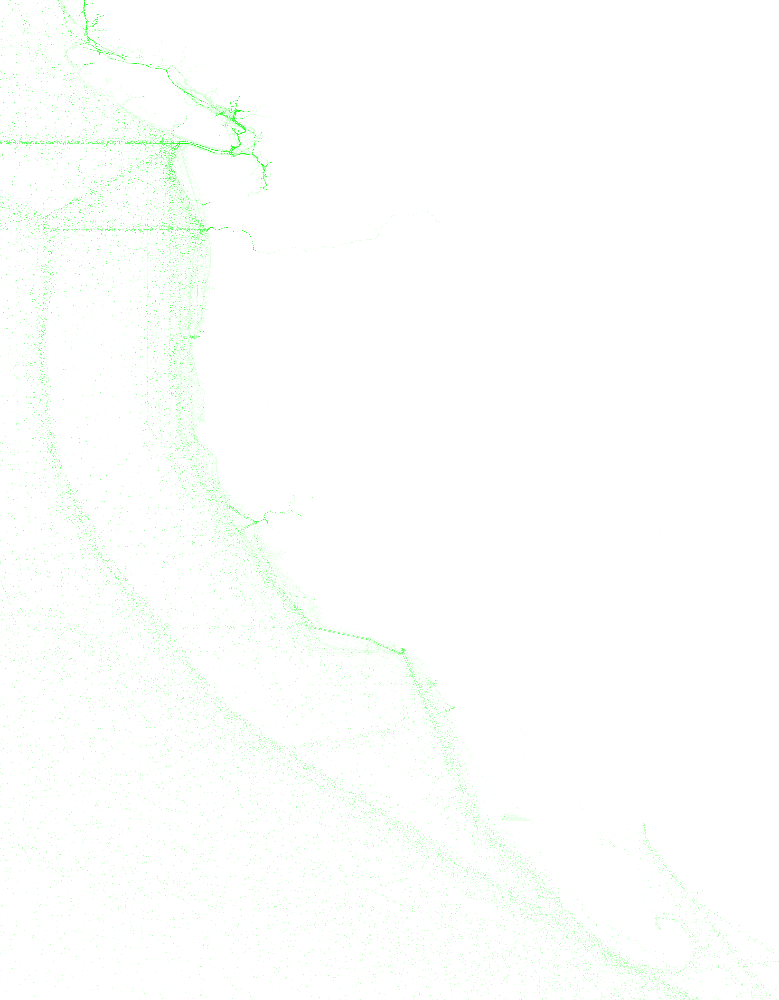

In [6]:
#display map
m

#### 5. Results

See website link in github readme for discussion of results


#### 6. Deploy

Save file for website.

In [7]:

# Save the map as an HTML file
m.save('Output/002_LA.html')
